In [1]:
# Install Ultralytics library
!pip install ultralytics

In [2]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')

# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import yaml
from PIL import Image
from ultralytics import YOLO
from IPython.display import Video

In [3]:
# Configure the visual appearance of Seaborn plots
sns.set(rc={'axes.facecolor': '#eae8fa'}, style='darkgrid')

In [4]:
# Load a pretrained YOLOv8n model from Ultralytics
model = YOLO('yolov8n.pt')


image 1/1 D:\Model 1\Vehicle_Detection_Image_Dataset\sample_image.jpg: 384x640 5 cars, 165.9ms
Speed: 7.6ms preprocess, 165.9ms inference, 12.7ms postprocess per image at shape (1, 3, 384, 640)


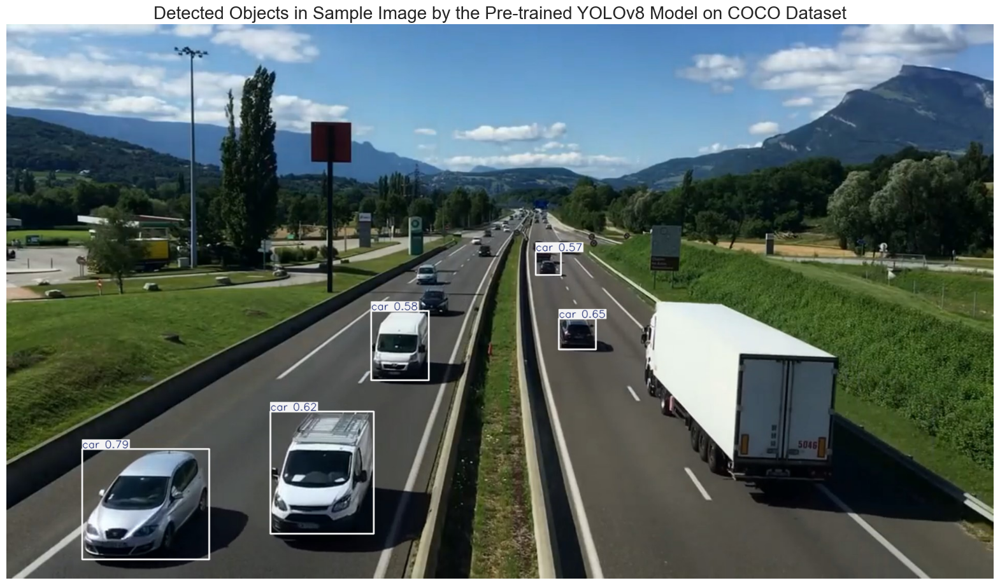

In [5]:
# Path to the image file
image_path = 'D:/Model 1/Vehicle_Detection_Image_Dataset/sample_image.jpg'

# Perform inference on the provided image(s)
results = model.predict(source=image_path, 
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.5)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()

In [6]:
# Define the dataset_path
dataset_path = r'D:/Model 1/Vehicle_Detection_Image_Dataset'

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'data.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
- Vehicle
nc: 1
roboflow:
  license: CC BY 4.0
  project: vehicle_detection_yolov8
  url: https://universe.roboflow.com/farzad/vehicle_detection_yolov8/dataset/3
  version: 3
  workspace: farzad
train: ../train/images
val: ../valid/images



In [7]:
# Set paths for training and validation image sets
train_images_path = os.path.join(dataset_path, 'train', 'images')
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):  
        num_train_images += 1
        image_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'): 
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images: 536
Number of validation images: 90
All training images have the same size: (640, 640)
All validation images have the same size: (640, 640)


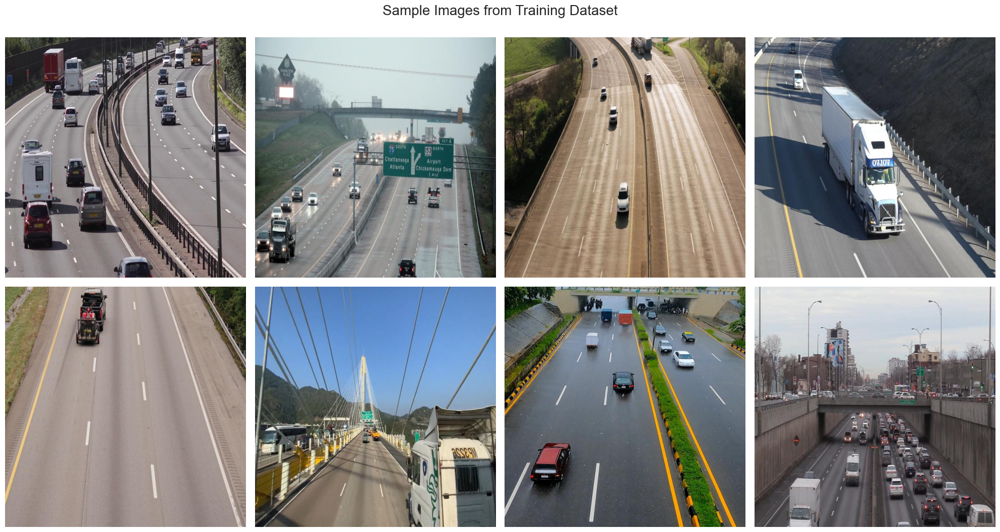

In [8]:
# List all jpg images in the directory
image_files = [file for file in os.listdir(train_images_path) if file.endswith('.jpg')]

# Select 8 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 8)]

# Create a 2x4 subplot
fig, axes = plt.subplots(2, 4, figsize=(20, 11))

# Display each of the selected images
for ax, img_file in zip(axes.ravel(), selected_images):
    img_path = os.path.join(train_images_path, img_file)
    image = Image.open(img_path)
    ax.imshow(image)
    ax.axis('off')  

plt.suptitle('Sample Images from Training Dataset', fontsize=20)
plt.tight_layout()
plt.show()

In [9]:
import wandb
import torch

# Login to Weights and Biases using your API key
wandb.login(key="f206b722e98317308ccec4166b10d7669c3d2a0a")

# Check CUDA availability
use_cuda = torch.cuda.is_available()
device = 'cuda:0' if use_cuda else 'cpu'

# Print out CUDA availability for debugging
print("CUDA available:", use_cuda)
print("Device being used:", device)

# Path to your dataset configuration file
yaml_file_path = "D:\Model 1\Vehicle_Detection_Image_Dataset\data.yaml"  # Update with your actual file path

# Train the model on your custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=100,              # Number of epochs to train for
    imgsz=640,               # Size of input images as integer
    device=device,           # Device to run on ('cpu' or 'cuda:0')
    patience=50,             # Epochs to wait for no observable improvement for early stopping of training
    batch=32,                # Number of images per batch
    optimizer='auto',        # Optimizer to use
    lr0=0.0001,              # Initial learning rate 
    lrf=0.1,                 # Final learning rate (lr0 * lrf)
    dropout=0.1,             # Use dropout regularization
    seed=0                   # Random seed for reproducibility
)

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: aryan205 (aryan205-vellore-institute-of-technology). Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: C:\Users\Asus\_netrc


CUDA available: False
Device being used: cpu
New https://pypi.org/project/ultralytics/8.2.90 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.2.89  Python-3.12.0 torch-2.4.1+cpu CPU (AMD Ryzen 5 5600H with Radeon Graphics)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=D:\Model 1\Vehicle_Detection_Image_Dataset\data.yaml, epochs=100, time=None, patience=50, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, ag

Freezing layer 'model.22.dfl.conv.weight'


train: Scanning D:\Model 1\Vehicle_Detection_Image_Dataset\train\labels.cache... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<?, ?it/s]
val: Scanning D:\Model 1\Vehicle_Detection_Image_Dataset\valid\labels.cache... 90 images, 0 backgrounds, 0 corrupt: 100%|██████████| 90/90 [00:00<?, ?it/s]

Plotting labels to runs\detect\train5\labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs\detect\train5
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      2.342       2.82      1.791        363        640: 100%|██████████| 17/17 [03:29<00:00, 12.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.58s/it]

                   all         90        937    0.00319     0.0918    0.00206   0.000651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100         0G      1.502      1.297      1.191        409        640: 100%|██████████| 17/17 [02:59<00:00, 10.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.64s/it]

                   all         90        937    0.00593      0.171    0.00985    0.00431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100         0G      1.299     0.9894      1.071        362        640: 100%|██████████| 17/17 [03:00<00:00, 10.64s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.60s/it]

                   all         90        937      0.786      0.352      0.455      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100         0G      1.208     0.8823       1.03        525        640: 100%|██████████| 17/17 [03:05<00:00, 10.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.80s/it]

                   all         90        937       0.83      0.769      0.843       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100         0G      1.184      0.833       1.02        401        640: 100%|██████████| 17/17 [03:03<00:00, 10.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.72s/it]

                   all         90        937      0.841      0.837      0.899      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100         0G      1.162     0.8064      1.012        432        640: 100%|██████████| 17/17 [03:02<00:00, 10.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.61s/it]

                   all         90        937      0.866      0.854      0.927      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100         0G      1.127     0.7878     0.9951        357        640: 100%|██████████| 17/17 [03:01<00:00, 10.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.40s/it]

                   all         90        937      0.826      0.883      0.909      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G      1.104     0.7586      0.993        389        640: 100%|██████████| 17/17 [03:01<00:00, 10.67s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.48s/it]

                   all         90        937       0.79      0.911      0.915      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100         0G      1.111     0.7254     0.9965        274        640: 100%|██████████| 17/17 [03:02<00:00, 10.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.49s/it]

                   all         90        937      0.848      0.918      0.934      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100         0G      1.111     0.7187     0.9923        373        640: 100%|██████████| 17/17 [03:06<00:00, 11.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.61s/it]

                   all         90        937      0.871      0.907      0.957      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100         0G      1.096     0.6989     0.9875        325        640: 100%|██████████| 17/17 [03:06<00:00, 10.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.34s/it]

                   all         90        937      0.868      0.923      0.948       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100         0G      1.096     0.6618     0.9844        360        640: 100%|██████████| 17/17 [03:10<00:00, 11.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.63s/it]

                   all         90        937      0.872      0.901       0.95      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100         0G       1.07      0.651     0.9733        348        640: 100%|██████████| 17/17 [03:12<00:00, 11.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.65s/it]

                   all         90        937      0.907      0.902       0.96      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100         0G      1.064     0.6667     0.9748        392        640: 100%|██████████| 17/17 [03:11<00:00, 11.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.65s/it]

                   all         90        937      0.928      0.892      0.962      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100         0G      1.045     0.6401     0.9698        321        640: 100%|██████████| 17/17 [03:07<00:00, 11.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.32s/it]

                   all         90        937      0.896      0.908      0.965      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100         0G      1.054     0.6324     0.9593        370        640: 100%|██████████| 17/17 [03:00<00:00, 10.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.25s/it]

                   all         90        937      0.877      0.919      0.959      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100         0G      1.064     0.6389     0.9675        326        640: 100%|██████████| 17/17 [03:02<00:00, 10.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.47s/it]

                   all         90        937       0.89      0.919      0.962      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100         0G      1.019     0.6098     0.9583        282        640: 100%|██████████| 17/17 [03:08<00:00, 11.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.55s/it]

                   all         90        937      0.887      0.909      0.954      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100         0G      1.027     0.5961     0.9591        389        640: 100%|██████████| 17/17 [03:06<00:00, 10.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.38s/it]

                   all         90        937      0.897      0.911      0.963      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100         0G      1.018     0.5843     0.9591        324        640: 100%|██████████| 17/17 [03:28<00:00, 12.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.05s/it]

                   all         90        937      0.901      0.931      0.969      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100         0G      1.024     0.5888     0.9582        363        640: 100%|██████████| 17/17 [04:28<00:00, 15.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.06s/it]

                   all         90        937      0.908      0.905      0.964      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100         0G      1.022     0.5747     0.9548        407        640: 100%|██████████| 17/17 [04:26<00:00, 15.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.86s/it]

                   all         90        937        0.9      0.914      0.962      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100         0G      1.006      0.574     0.9531        193        640: 100%|██████████| 17/17 [04:18<00:00, 15.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.88s/it]

                   all         90        937      0.893      0.909      0.962      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100         0G      1.004     0.5619     0.9462        307        640: 100%|██████████| 17/17 [04:19<00:00, 15.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.99s/it]

                   all         90        937      0.901      0.926       0.97      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100         0G     0.9957     0.5651     0.9478        398        640: 100%|██████████| 17/17 [04:22<00:00, 15.46s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.86s/it]

                   all         90        937      0.876      0.934      0.966      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100         0G      1.011     0.5687     0.9476        376        640: 100%|██████████| 17/17 [04:24<00:00, 15.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.98s/it]

                   all         90        937      0.905      0.934      0.976      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100         0G     0.9801     0.5491     0.9418        352        640: 100%|██████████| 17/17 [04:21<00:00, 15.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.98s/it]

                   all         90        937      0.915      0.907      0.972      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100         0G     0.9776     0.5491     0.9451        405        640: 100%|██████████| 17/17 [04:21<00:00, 15.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.85s/it]

                   all         90        937      0.911      0.916      0.969      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100         0G     0.9994     0.5635     0.9468        275        640: 100%|██████████| 17/17 [04:30<00:00, 15.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.93s/it]

                   all         90        937      0.899      0.895      0.961      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100         0G     0.9736     0.5458     0.9439        437        640: 100%|██████████| 17/17 [02:54<00:00, 10.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.03s/it]

                   all         90        937      0.901      0.922      0.969      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100         0G     0.9771     0.5504     0.9399        302        640: 100%|██████████| 17/17 [02:56<00:00, 10.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.97s/it]

                   all         90        937      0.916        0.9      0.972       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100         0G     0.9807      0.542     0.9455        298        640: 100%|██████████| 17/17 [02:56<00:00, 10.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.02s/it]

                   all         90        937      0.906      0.927      0.973      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100         0G     0.9805     0.5434     0.9415        274        640: 100%|██████████| 17/17 [02:55<00:00, 10.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.99s/it]

                   all         90        937      0.889      0.934      0.972       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100         0G     0.9659     0.5516     0.9369        321        640: 100%|██████████| 17/17 [02:56<00:00, 10.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.08s/it]

                   all         90        937       0.93      0.905      0.976      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100         0G     0.9702     0.5367     0.9367        344        640: 100%|██████████| 17/17 [02:57<00:00, 10.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.02s/it]

                   all         90        937      0.862      0.935      0.937      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100         0G     0.9869     0.5513     0.9437        400        640: 100%|██████████| 17/17 [02:54<00:00, 10.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.03s/it]

                   all         90        937      0.905      0.938      0.973      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100         0G     0.9647     0.5312     0.9373        341        640: 100%|██████████| 17/17 [02:55<00:00, 10.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.02s/it]

                   all         90        937      0.914      0.922      0.966      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100         0G     0.9534     0.5276     0.9366        366        640: 100%|██████████| 17/17 [03:57<00:00, 13.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.94s/it]

                   all         90        937      0.882      0.945      0.973      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100         0G     0.9533     0.5212      0.937        411        640: 100%|██████████| 17/17 [04:21<00:00, 15.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.81s/it]

                   all         90        937      0.921      0.918      0.973       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100         0G     0.9347     0.5125     0.9242        354        640: 100%|██████████| 17/17 [04:22<00:00, 15.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.08s/it]

                   all         90        937      0.921      0.925      0.974      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100         0G     0.9435     0.5062     0.9337        376        640: 100%|██████████| 17/17 [04:22<00:00, 15.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.81s/it]

                   all         90        937      0.907      0.932      0.971      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100         0G     0.9442     0.5196     0.9273        394        640: 100%|██████████| 17/17 [04:21<00:00, 15.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.01s/it]

                   all         90        937      0.911      0.933      0.975      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100         0G     0.9408     0.5179     0.9345        423        640: 100%|██████████| 17/17 [04:32<00:00, 16.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.76s/it]

                   all         90        937      0.901      0.937      0.972      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100         0G     0.9437      0.518     0.9311        321        640: 100%|██████████| 17/17 [04:19<00:00, 15.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.88s/it]

                   all         90        937      0.915      0.933      0.974      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100         0G      0.942     0.5073     0.9205        294        640: 100%|██████████| 17/17 [03:46<00:00, 13.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.02s/it]

                   all         90        937      0.902      0.932      0.973      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100         0G     0.9442     0.5195     0.9308        370        640: 100%|██████████| 17/17 [02:55<00:00, 10.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.15s/it]

                   all         90        937      0.929       0.92      0.973      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100         0G     0.9159      0.497     0.9237        327        640: 100%|██████████| 17/17 [02:56<00:00, 10.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.03s/it]

                   all         90        937      0.925      0.928      0.975      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100         0G     0.9298     0.4904     0.9313        429        640: 100%|██████████| 17/17 [03:06<00:00, 10.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.89s/it]

                   all         90        937      0.898      0.951      0.974      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100         0G     0.9365     0.4957     0.9321        356        640: 100%|██████████| 17/17 [04:22<00:00, 15.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.90s/it]

                   all         90        937      0.935      0.913      0.975      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100         0G     0.9233     0.4939     0.9258        292        640: 100%|██████████| 17/17 [04:19<00:00, 15.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.80s/it]

                   all         90        937      0.916      0.936      0.979       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100         0G      0.922     0.4862     0.9269        389        640: 100%|██████████| 17/17 [04:19<00:00, 15.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.78s/it]

                   all         90        937      0.908       0.95      0.975      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100         0G     0.9116     0.4848      0.919        367        640: 100%|██████████| 17/17 [04:17<00:00, 15.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.74s/it]

                   all         90        937      0.906      0.937      0.974       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100         0G     0.9126     0.4952     0.9216        356        640: 100%|██████████| 17/17 [04:18<00:00, 15.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.67s/it]

                   all         90        937       0.91      0.936      0.973      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100         0G     0.9144     0.4847     0.9195        356        640: 100%|██████████| 17/17 [04:16<00:00, 15.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.80s/it]

                   all         90        937       0.89      0.936      0.969      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100         0G     0.9094     0.4777     0.9258        379        640: 100%|██████████| 17/17 [02:54<00:00, 10.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.02s/it]

                   all         90        937      0.895      0.926      0.964      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100         0G     0.9072     0.4842     0.9209        380        640: 100%|██████████| 17/17 [02:53<00:00, 10.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  6.00s/it]

                   all         90        937      0.923      0.919      0.975       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100         0G     0.9099     0.4854       0.92        317        640: 100%|██████████| 17/17 [02:54<00:00, 10.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.98s/it]

                   all         90        937      0.921      0.919       0.97      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100         0G     0.8991     0.4757     0.9134        427        640: 100%|██████████| 17/17 [02:54<00:00, 10.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.01s/it]

                   all         90        937      0.912      0.931      0.973      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100         0G     0.9021     0.4794     0.9212        324        640: 100%|██████████| 17/17 [02:54<00:00, 10.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.96s/it]

                   all         90        937      0.894      0.937      0.969      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100         0G     0.8973     0.4775     0.9165        383        640: 100%|██████████| 17/17 [02:55<00:00, 10.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.98s/it]

                   all         90        937      0.864      0.945      0.957      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100         0G     0.8934     0.4712     0.9158        276        640: 100%|██████████| 17/17 [02:54<00:00, 10.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.98s/it]

                   all         90        937        0.9      0.937      0.971      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100         0G     0.8819     0.4728     0.9161        290        640: 100%|██████████| 17/17 [02:53<00:00, 10.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.98s/it]

                   all         90        937      0.911      0.925      0.973      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100         0G     0.8862      0.471     0.9115        344        640: 100%|██████████| 17/17 [02:54<00:00, 10.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.04s/it]

                   all         90        937      0.903      0.935       0.97      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100         0G     0.8824     0.4717     0.9117        356        640: 100%|██████████| 17/17 [02:53<00:00, 10.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.01s/it]

                   all         90        937       0.93       0.92      0.978      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100         0G     0.8775     0.4643     0.9133        282        640: 100%|██████████| 17/17 [02:54<00:00, 10.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.99s/it]

                   all         90        937      0.917      0.941      0.972      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100         0G     0.8734     0.4573     0.9065        372        640: 100%|██████████| 17/17 [02:53<00:00, 10.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.99s/it]

                   all         90        937      0.903      0.926      0.969      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100         0G     0.8726     0.4559     0.9152        290        640: 100%|██████████| 17/17 [02:53<00:00, 10.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.94s/it]

                   all         90        937      0.902      0.942       0.97      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100         0G     0.8782     0.4677     0.9171        347        640: 100%|██████████| 17/17 [02:53<00:00, 10.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.04s/it]

                   all         90        937      0.901      0.918      0.963      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100         0G     0.8832     0.4673     0.9127        342        640: 100%|██████████| 17/17 [02:55<00:00, 10.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.98s/it]

                   all         90        937        0.9      0.932      0.969      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100         0G     0.8958     0.4647     0.9164        191        640: 100%|██████████| 17/17 [02:54<00:00, 10.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.06s/it]

                   all         90        937      0.891      0.947      0.969      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100         0G      0.867     0.4571     0.9109        356        640: 100%|██████████| 17/17 [02:56<00:00, 10.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.01s/it]

                   all         90        937      0.901      0.948      0.973      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100         0G     0.8727     0.4513     0.9113        326        640: 100%|██████████| 17/17 [02:56<00:00, 10.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.91s/it]

                   all         90        937      0.904      0.932      0.975      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100         0G     0.8636      0.459     0.9057        439        640: 100%|██████████| 17/17 [02:53<00:00, 10.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.96s/it]

                   all         90        937      0.921      0.934      0.978      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100         0G     0.8627     0.4519     0.9113        268        640: 100%|██████████| 17/17 [02:52<00:00, 10.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.99s/it]

                   all         90        937      0.903       0.94      0.969      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100         0G     0.8596     0.4425     0.9037        337        640: 100%|██████████| 17/17 [02:55<00:00, 10.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.04s/it]

                   all         90        937       0.91      0.934      0.972      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100         0G     0.8571     0.4513     0.9005        387        640: 100%|██████████| 17/17 [02:55<00:00, 10.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.97s/it]

                   all         90        937      0.885      0.932      0.966      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100         0G     0.8586      0.451     0.9083        316        640: 100%|██████████| 17/17 [02:54<00:00, 10.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.93s/it]

                   all         90        937      0.913      0.939      0.966      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100         0G     0.8536     0.4483     0.9017        379        640: 100%|██████████| 17/17 [02:57<00:00, 10.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.15s/it]

                   all         90        937      0.904      0.935      0.971      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100         0G     0.8533     0.4507     0.9048        217        640: 100%|██████████| 17/17 [02:54<00:00, 10.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.95s/it]

                   all         90        937      0.902      0.937      0.971      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100         0G     0.8547     0.4384     0.9084        293        640: 100%|██████████| 17/17 [02:54<00:00, 10.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.99s/it]

                   all         90        937      0.921      0.921      0.968      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100         0G     0.8448     0.4408     0.9051        240        640: 100%|██████████| 17/17 [02:58<00:00, 10.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.05s/it]

                   all         90        937      0.903      0.949      0.968      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100         0G     0.8519     0.4393     0.9077        335        640: 100%|██████████| 17/17 [03:01<00:00, 10.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.14s/it]

                   all         90        937      0.907      0.934       0.97      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100         0G     0.8394     0.4328     0.8936        321        640: 100%|██████████| 17/17 [02:58<00:00, 10.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.07s/it]

                   all         90        937      0.897      0.953      0.973      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100         0G     0.8351     0.4328     0.8987        414        640: 100%|██████████| 17/17 [02:56<00:00, 10.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.97s/it]

                   all         90        937       0.89      0.945      0.969      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100         0G      0.836     0.4349     0.8991        303        640: 100%|██████████| 17/17 [02:56<00:00, 10.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.10s/it]

                   all         90        937      0.916      0.946      0.975      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100         0G     0.8315     0.4267     0.9014        267        640: 100%|██████████| 17/17 [02:56<00:00, 10.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.09s/it]

                   all         90        937      0.917      0.932      0.968      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100         0G     0.8432     0.4315      0.903        487        640: 100%|██████████| 17/17 [02:54<00:00, 10.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.10s/it]

                   all         90        937      0.911      0.947      0.976      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100         0G     0.8346     0.4348     0.8976        357        640: 100%|██████████| 17/17 [02:56<00:00, 10.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.09s/it]

                   all         90        937      0.893      0.949      0.969      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100         0G     0.8252     0.4219     0.8991        318        640: 100%|██████████| 17/17 [02:56<00:00, 10.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  6.00s/it]

                   all         90        937        0.9      0.948      0.972      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100         0G     0.8107     0.4232     0.8986        388        640: 100%|██████████| 17/17 [02:55<00:00, 10.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.06s/it]

                   all         90        937       0.91      0.936       0.97       0.73


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100         0G     0.8187     0.4146     0.8996        259        640: 100%|██████████| 17/17 [02:52<00:00, 10.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.05s/it]

                   all         90        937      0.914       0.93      0.967      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100         0G     0.8088     0.4043     0.8946        209        640: 100%|██████████| 17/17 [02:51<00:00, 10.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.05s/it]

                   all         90        937      0.909      0.921      0.972      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100         0G     0.8131        0.4     0.8965        165        640: 100%|██████████| 17/17 [02:52<00:00, 10.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.04s/it]

                   all         90        937      0.916      0.928      0.972      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100         0G     0.7985     0.3965     0.8979        286        640: 100%|██████████| 17/17 [02:52<00:00, 10.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.08s/it]

                   all         90        937      0.908      0.941      0.969      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100         0G     0.8014     0.3955     0.8918        304        640: 100%|██████████| 17/17 [02:52<00:00, 10.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.44s/it]

                   all         90        937      0.893      0.948       0.97      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100         0G       0.78     0.3853     0.8872        142        640: 100%|██████████| 17/17 [02:54<00:00, 10.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.07s/it]

                   all         90        937      0.893      0.946      0.969      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100         0G      0.796     0.3888     0.8895        191        640: 100%|██████████| 17/17 [02:52<00:00, 10.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.02s/it]

                   all         90        937      0.893      0.949      0.969      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100         0G     0.7843     0.3845     0.8898        309        640: 100%|██████████| 17/17 [02:53<00:00, 10.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.00s/it]

                   all         90        937      0.919      0.932      0.974      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100         0G     0.7794     0.3862     0.8852        205        640: 100%|██████████| 17/17 [02:52<00:00, 10.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.05s/it]

                   all         90        937      0.913      0.947      0.972       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100         0G     0.7758     0.3838     0.8893        233        640: 100%|██████████| 17/17 [02:53<00:00, 10.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:12<00:00,  6.04s/it]

                   all         90        937      0.901      0.946      0.972       0.74



100 epochs completed in 5.863 hours.
Optimizer stripped from runs\detect\train5\weights\last.pt, 6.3MB
Optimizer stripped from runs\detect\train5\weights\best.pt, 6.3MB

Validating runs\detect\train5\weights\best.pt...
Ultralytics YOLOv8.2.89  Python-3.12.0 torch-2.4.1+cpu CPU (AMD Ryzen 5 5600H with Radeon Graphics)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:09<00:00,  4.52s/it]


                   all         90        937      0.911      0.947      0.976      0.742
Speed: 3.6ms preprocess, 87.1ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to runs\detect\train5


lr/pg0,▁▄███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg1,▁▄███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg2,▁▄███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
metrics/mAP50(B),▁▄██████████████████████████████████████
metrics/mAP50-95(B),▁▃▇▇▇█▇▇████████████████████████████████
metrics/precision(B),▁▇▇▇▇███████████████████████████████████
metrics/recall(B),▁▃▇█████████████████████████████████████
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,█▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


In [47]:
# Define the path to the directory
post_training_files_path = r'D:/Model 1/runs/detect/train5'

# List the files in the directory (use os module in Windows)
import os
os.listdir(post_training_files_path)

['args.yaml',
 'confusion_matrix.png',
 'confusion_matrix_normalized.png',
 'F1_curve.png',
 'labels.jpg',
 'labels_correlogram.jpg',
 'PR_curve.png',
 'P_curve.png',
 'results.csv',
 'results.png',
 'R_curve.png',
 'train_batch0.jpg',
 'train_batch1.jpg',
 'train_batch1530.jpg',
 'train_batch1531.jpg',
 'train_batch1532.jpg',
 'train_batch2.jpg',
 'val_batch0_labels.jpg',
 'val_batch0_pred.jpg',
 'val_batch1_labels.jpg',
 'val_batch1_pred.jpg',
 'weights']

In [48]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='#141140', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='orangered', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

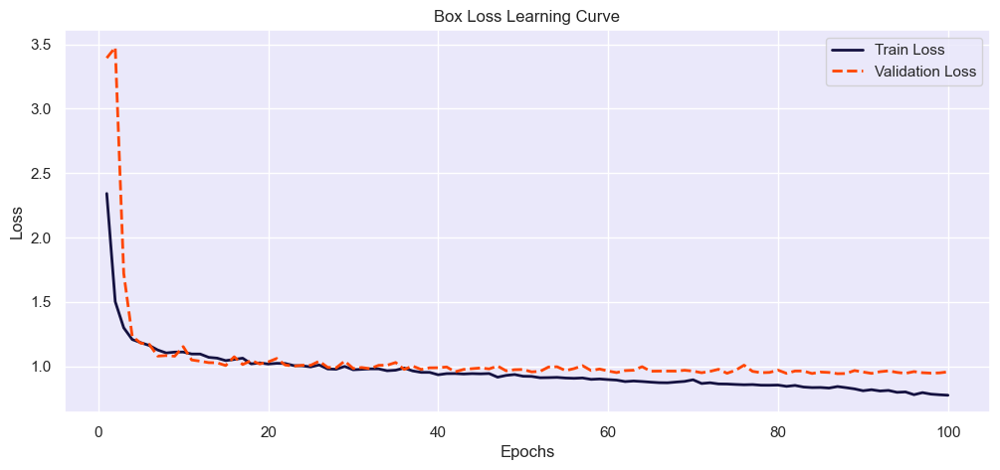

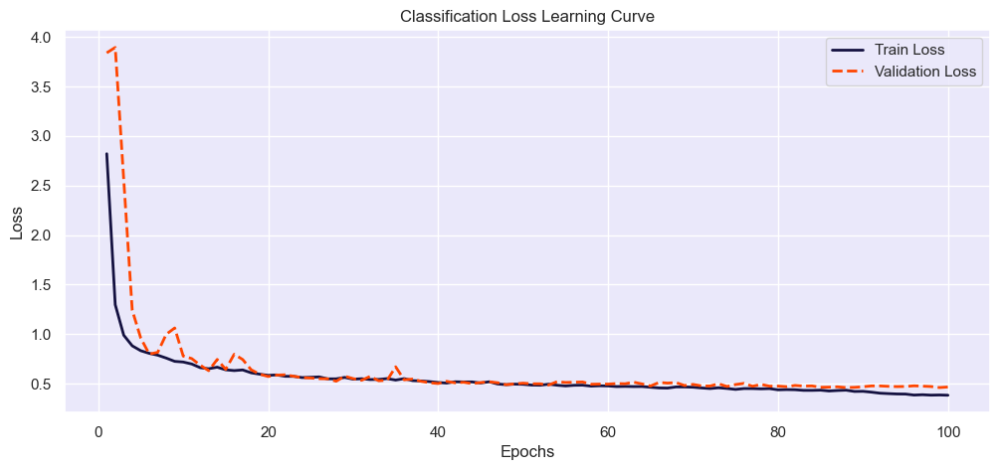

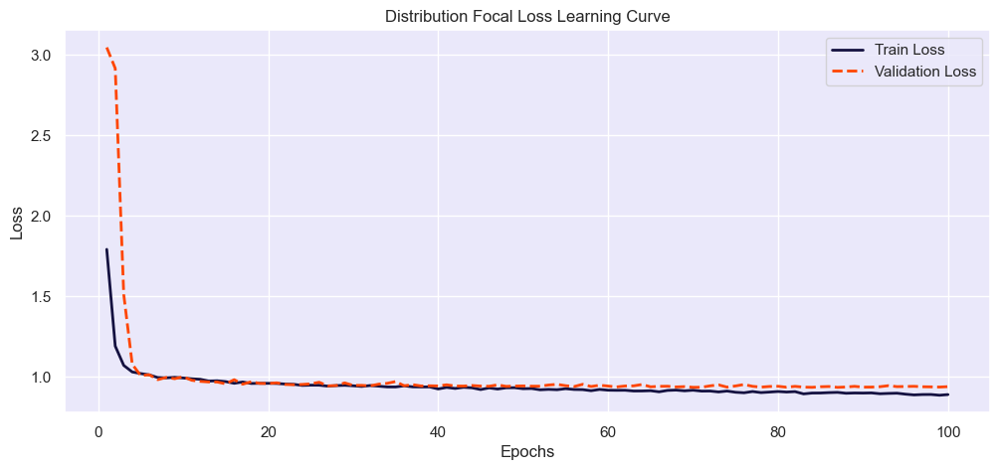

In [49]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

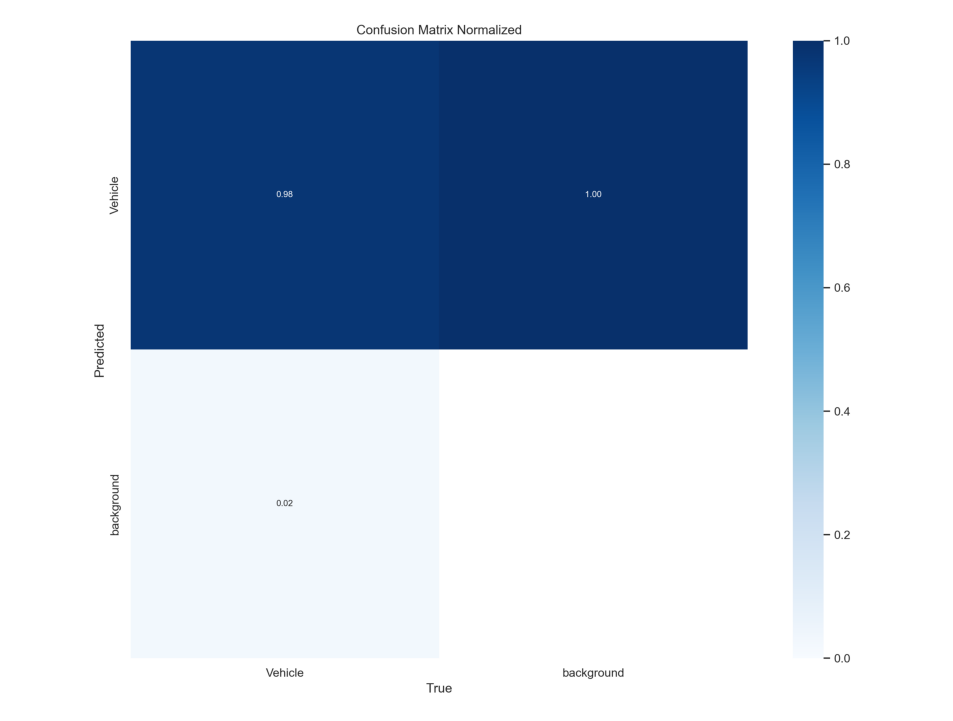

In [51]:
# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(post_training_files_path, 'confusion_matrix_normalized.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off') 
plt.show()


In [10]:
# Construct the path to the best model weights file using os.path.join
best_model_path = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model = YOLO(best_model_path)

# Validate the best model using the validation set with default parameters
metrics = best_model.val(split='val')

NameError: name 'post_training_files_path' is not defined

In [53]:
# Convert the dictionary to a pandas DataFrame and use the keys as the index
metrics_df = pd.DataFrame.from_dict(metrics.results_dict, orient='index', columns=['Metric Value'])

# Display the DataFrame
metrics_df.round(3)

,Metric Value
metrics/precision(B),0.911
metrics/recall(B),0.947
metrics/mAP50(B),0.976
metrics/mAP50-95(B),0.742
fitness,0.765



image 1/1 D:\Model 1\Vehicle_Detection_Image_Dataset\valid\images\10_mp4-0_jpg.rf.08b3bd34bbb73fb80c2d662c34474a98.jpg: 640x640 21 Vehicles, 83.9ms
Speed: 6.3ms preprocess, 83.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 D:\Model 1\Vehicle_Detection_Image_Dataset\valid\images\11_mp4-15_jpg.rf.b1bdb8b4864b5bed3c78f1a70e2dc011.jpg: 640x640 13 Vehicles, 64.1ms
Speed: 2.0ms preprocess, 64.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 D:\Model 1\Vehicle_Detection_Image_Dataset\valid\images\12_mp4-27_jpg.rf.2b272befa75f6ccd269223ccc84e5391.jpg: 640x640 5 Vehicles, 61.4ms
Speed: 2.5ms preprocess, 61.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 D:\Model 1\Vehicle_Detection_Image_Dataset\valid\images\14_mp4-24_jpg.rf.57d5fe50d543f58e3b1f761ee53e1aa8.jpg: 640x640 6 Vehicles, 63.0ms
Speed: 2.0ms preprocess, 63.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 D:\M

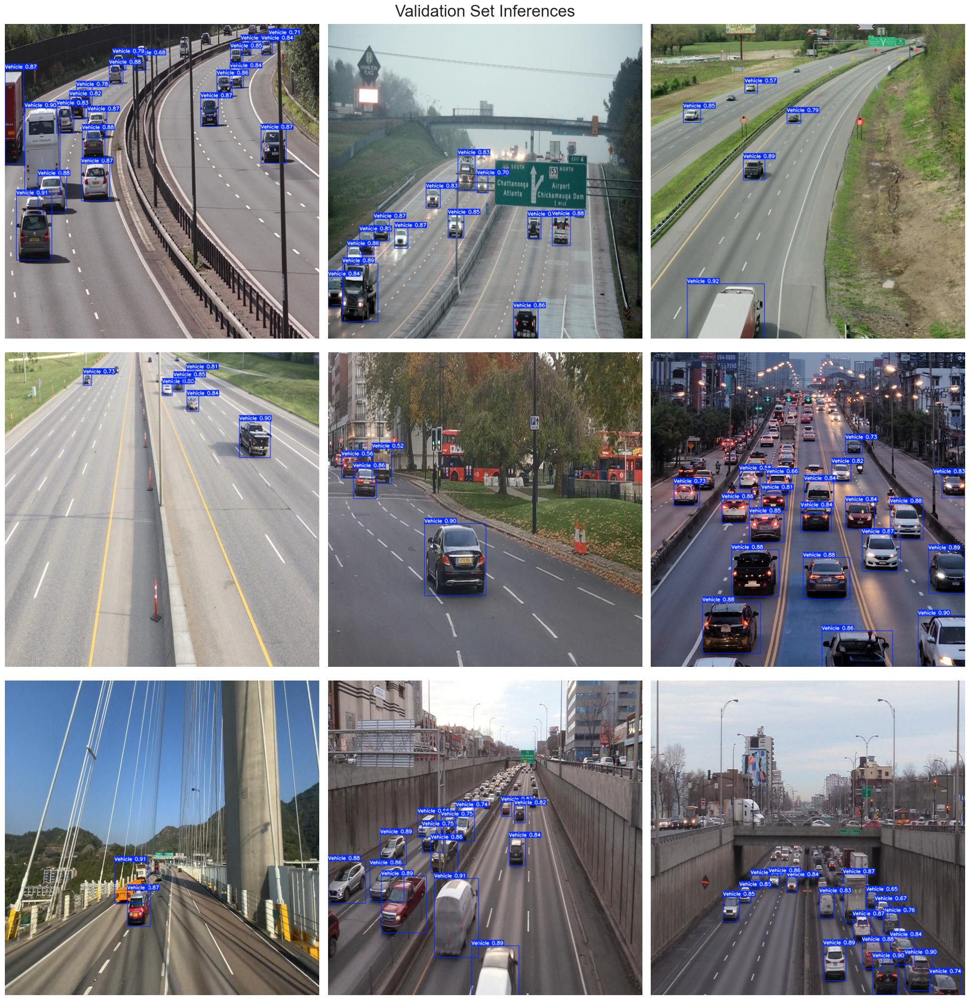

In [54]:
# Define the path to the validation images
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# List all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

# Initialize the subplot
fig, axes = plt.subplots(3, 3, figsize=(20, 21))
fig.suptitle('Validation Set Inferences', fontsize=24)

# Perform inference on each selected image and display it
for i, ax in enumerate(axes.flatten()):
    image_path = os.path.join(valid_images_path, selected_images[i])
    results = best_model.predict(source=image_path, imgsz=640, conf=0.5)
    annotated_image = results[0].plot(line_width=1)
    annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')

plt.tight_layout()
plt.show()


image 1/1 D:\Model 1\Vehicle_Detection_Image_Dataset\sample_image.jpg: 384x640 8 Vehicles, 52.7ms
Speed: 1.1ms preprocess, 52.7ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


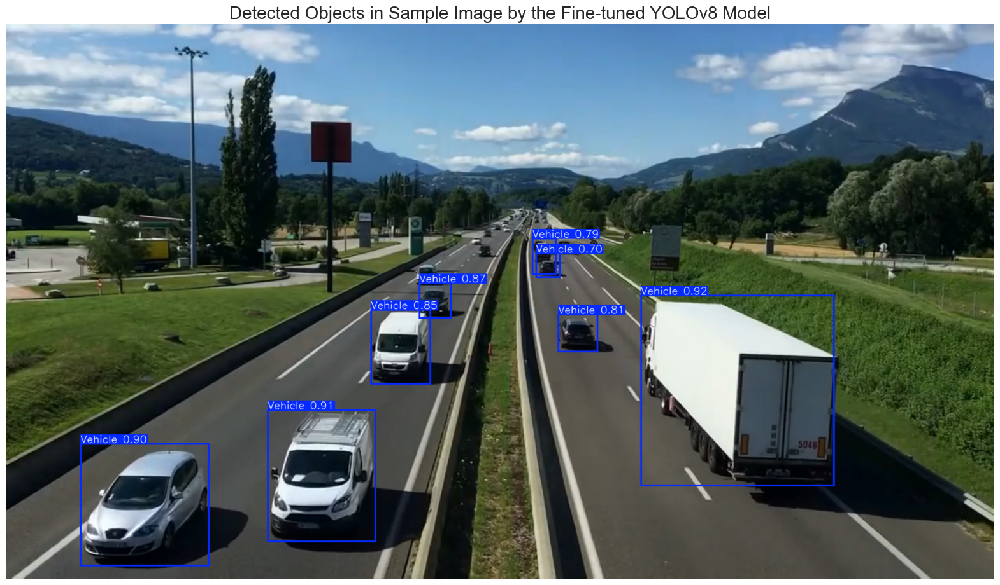

In [57]:
# Path to the image file
sample_image_path = 'D:\Model 1\Vehicle_Detection_Image_Dataset\sample_image.jpg'

# Perform inference on the provided image using best model
results = best_model.predict(source=sample_image_path, imgsz=640, conf=0.7) 
                        
# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Fine-tuned YOLOv8 Model', fontsize=20)
plt.axis('off')
plt.show()

In [11]:
# Define the path to the sample video in the dataset
dataset_video_path = 'D:\Model 1\Vehicle_Detection_Image_Dataset\sample_video.mp4'

# Define the destination path in the working directory
video_path = r'D:\Model 1\runs\detect\train5\sample_video.mp4'

# Copy the video file from its original location in the dataset to the current working directory in Kaggle for further processing
shutil.copyfile(dataset_video_path, video_path)

# Initiate vehicle detection on the sample video using the best performing model and save the output
best_model.predict(source=video_path, save=True)

<>:2: SyntaxWarning: invalid escape sequence '\M'
<>:2: SyntaxWarning: invalid escape sequence '\M'
C:\Users\Asus\AppData\Local\Temp\ipykernel_1456\3868587644.py:2: SyntaxWarning: invalid escape sequence '\M'
  dataset_video_path = 'D:\Model 1\Vehicle_Detection_Image_Dataset\sample_video.mp4'


NameError: name 'best_model' is not defined

In [12]:
from IPython.display import Video

# Define the path to your video file
video_path = r"D:\Model 1\runs\detect\predict\sample_video.mp4"

# Display the video within the Jupyter Notebook
display(Video(video_path, embed=True, width=960))

In [13]:
import cv2
import numpy as np

# Define the threshold for considering traffic as heavy
heavy_traffic_threshold = 10

# Define the vertices for the quadrilaterals
vertices1 = np.array([(465, 350), (609, 350), (510, 630), (2, 630)], dtype=np.int32)
vertices2 = np.array([(678, 350), (815, 350), (1203, 630), (743, 630)], dtype=np.int32)

# Define the vertical range for the slice and lane threshold
x1, x2 = 325, 635 
lane_threshold = 609

# Define the positions for the text annotations on the image
text_position_left_lane = (10, 50)
text_position_right_lane = (820, 50)
intensity_position_left_lane = (10, 100)
intensity_position_right_lane = (820, 100)

# Define font, scale, and colors for the annotations
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 1
font_color = (255, 255, 255)    # White color for text
background_color = (0, 0, 255)  # Red background for text

# Open the video
cap = cv2.VideoCapture(r"D:\Model 1\runs\detect\predict\sample_video.mp4")
if not cap.isOpened():
    print("Error: Could not open video.")
    exit()

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'XVID')
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
out = cv2.VideoWriter('traffic_density_analysis.avi', fourcc, 20.0, (frame_width, frame_height))

# Check if VideoWriter was initialized correctly
if not out.isOpened():
    print("Error: Could not open video writer.")
    cap.release()
    exit()

# Read until video is completed
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    
    # Create a copy of the original frame to modify
    detection_frame = frame.copy()
    
    # Black out the regions outside the specified vertical range
    detection_frame[:x1, :] = 0  # Black out from top to x1
    detection_frame[x2:, :] = 0  # Black out from x2 to the bottom of the frame
    
    # Perform inference on the modified frame
    results = best_model.predict(detection_frame, imgsz=640, conf=0.4)
    processed_frame = results[0].plot(line_width=1) if results[0] else frame.copy()
    
    # Restore the original top and bottom parts of the frame
    processed_frame[:x1, :] = frame[:x1, :].copy()
    processed_frame[x2:, :] = frame[x2:, :].copy()        
    
    # Draw the quadrilaterals on the processed frame
    cv2.polylines(processed_frame, [vertices1], isClosed=True, color=(0, 255, 0), thickness=2)
    cv2.polylines(processed_frame, [vertices2], isClosed=True, color=(255, 0, 0), thickness=2)
    
    # Retrieve the bounding boxes from the results
    bounding_boxes = results[0].boxes if results[0] else []

    # Initialize counters for vehicles in each lane
    vehicles_in_left_lane = 0
    vehicles_in_right_lane = 0

    # Loop through each bounding box to count vehicles in each lane
    for box in bounding_boxes.xyxy:
        # Check if the vehicle is in the left lane based on the x-coordinate of the bounding box
        if box[0] < lane_threshold:
            vehicles_in_left_lane += 1
        else:
            vehicles_in_right_lane += 1
            
    # Determine the traffic intensity for the left lane
    traffic_intensity_left = "Heavy" if vehicles_in_left_lane > heavy_traffic_threshold else "Smooth"
    # Determine the traffic intensity for the right lane
    traffic_intensity_right = "Heavy" if vehicles_in_right_lane > heavy_traffic_threshold else "Smooth"

    # Add a background rectangle for the left lane vehicle count
    cv2.rectangle(processed_frame, (text_position_left_lane[0]-10, text_position_left_lane[1] - 25), 
                  (text_position_left_lane[0] + 460, text_position_left_lane[1] + 10), background_color, -1)

    # Add the vehicle count text on top of the rectangle for the left lane
    cv2.putText(processed_frame, f'Vehicles in Left Lane: {vehicles_in_left_lane}', text_position_left_lane, 
                font, font_scale, font_color, 2, cv2.LINE_AA)

    # Add a background rectangle for the left lane traffic intensity
    cv2.rectangle(processed_frame, (intensity_position_left_lane[0]-10, intensity_position_left_lane[1] - 25), 
                  (intensity_position_left_lane[0] + 460, intensity_position_left_lane[1] + 10), background_color, -1)

    # Add the traffic intensity text on top of the rectangle for the left lane
    cv2.putText(processed_frame, f'Traffic Intensity: {traffic_intensity_left}', intensity_position_left_lane, 
                font, font_scale, font_color, 2, cv2.LINE_AA)

    # Add a background rectangle for the right lane vehicle count
    cv2.rectangle(processed_frame, (text_position_right_lane[0]-10, text_position_right_lane[1] - 25), 
                  (text_position_right_lane[0] + 460, text_position_right_lane[1] + 10), background_color, -1)

    # Add the vehicle count text on top of the rectangle for the right lane
    cv2.putText(processed_frame, f'Vehicles in Right Lane: {vehicles_in_right_lane}', text_position_right_lane, 
                font, font_scale, font_color, 2, cv2.LINE_AA)

    # Add a background rectangle for the right lane traffic intensity
    cv2.rectangle(processed_frame, (intensity_position_right_lane[0]-10, intensity_position_right_lane[1] - 25), 
                  (intensity_position_right_lane[0] + 460, intensity_position_right_lane[1] + 10), background_color, -1)

    # Add the traffic intensity text on top of the rectangle for the right lane
    cv2.putText(processed_frame, f'Traffic Intensity: {traffic_intensity_right}', intensity_position_right_lane, 
                font, font_scale, font_color, 2, cv2.LINE_AA)

    # Write the processed frame to the output video
    out.write(processed_frame)

    # Uncomment the following 3 lines if running this code on a local machine to view the real-time processing results
    # cv2.imshow('Real-time Analysis', processed_frame)
    # if cv2.waitKey(1) & 0xFF == ord('q'):  # Press Q on keyboard to exit the loop
    #     break

# Release the video capture and video write objects
cap.release()
out.release()

# Close all the frames
# cv2.destroyAllWindows()

NameError: name 'best_model' is not defined

In [14]:
# Convert the .avi video generated by our traffic density estimation app to .mp4 format for compatibility with notebook display
!ffmpeg -y -loglevel panic -i /kaggle/working/traffic_density_analysis.avi traffic_density_analysis.mp4

# Embed and display the processed sample video within the notebook
Video("traffic_density_analysis.mp4", embed=True, width=960)

'ffmpeg' is not recognized as an internal or external command,
operable program or batch file.


In [ ]:
# Export the model
best_model.export(format='onnx')